# Milestone II Companion Notebook - Data Exploration

## *By Laura Stagnaro and Sean Cafferty*

## Table of Contents:
    1. Numeric Features:
    
          1.1 - Examining Numeric Features with Histograms
          1.2 - Generating Tree Maps of POS Counts
          1.3 - Bar Chart of POS Ratios
          
    2. Semantic Features:
    
          2.1 - Comparative Wordclouds
          2.2 - Comparative Word Embeddings


In [ ]:
## ++++ WARNING! ++++++

## The CSV of preprocessed was too large to store in the GitHub. 
## The preprocessed data can be recreated by running the 'preprocessing' notebook available in the Github repository. 

## Also, the original WikiTrain_Large.csv will also run in this notebook

In [1]:
import pandas as pd
import numpy as np
import squarify 
import matplotlib.pyplot as plt

In [2]:
## Custom modules

from viz_engine import viz_engine,tools
from nlpeeps import feature_engine

In [3]:
## Read file

file = pd.read_csv('assets/wiki_train_preprocessed5.csv', encoding='utf-8')
SAMPLE_SIZE =10000
np.random.seed(911)
df = file.sample(SAMPLE_SIZE)

In [4]:
## Check out feature engine module options

feature_engine.choices()

['preprocessed_tokens',
 'tokens',
 'pos_tokens',
 'dep_tokens',
 'length',
 'average_word_length_with_stopwords',
 'average_word_length_no_stopwords',
 'std_word_length_with_stopwords',
 'std_word_length_no_stopwords',
 'pos_ratios',
 'dep_ratios',
 'advanced_words',
 'easy_words',
 'advanced_to_easy_ratio',
 'named_entity_counter',
 'punctuation',
 'odd_characters',
 'relative_pos',
 'overrepresented_pos_words',
 'overrepresented_neg_words']

In [5]:
## Check out viz module options

viz_engine.choices()

['histogrammer',
 'float_histogrammer',
 'word_embeddings_matrix',
 'word_embeddings_network',
 'pos_ratio_barchart',
 'adar_staticTreemap',
 'adar_interactiveTreemapsimple_wordcloud']

In [6]:
feature_engine.average_word_length_with_stopwords(df).head(1)
feature_engine.pos_ratios(df).head(1)

100%|██████████| 35/35 [00:00<00:00, 55.55it/s]


,original_text,label,tokens,length,advanced_word_count,advanced_words_ratio,named_entity_count,named_entity_ratio,punctuation_score,punctuation_ratio,...,WDT_ratio_norm,WP_ratio,WP_count_norm,WP_ratio_norm,WP$_ratio,WP$_count_norm,WP$_ratio_norm,WRB_ratio,WRB_count_norm,WRB_ratio_norm
174894,Louvers originated in the Middle Ages as lante...,1,"['Louvers', 'originated', 'in', 'the', 'Middle...",32,2,0.0625,1,0.03125,1,0.005376,...,0.260417,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [7]:
print(list(df.columns))

['original_text', 'label', 'tokens', 'length', 'advanced_word_count', 'advanced_words_ratio', 'named_entity_count', 'named_entity_ratio', 'punctuation_score', 'punctuation_ratio', 'CC', 'CD', 'DT', 'EX', 'FW', 'IN', 'JJ', 'JJR', 'JJS', 'LS', 'MD', 'NN', 'NNS', 'NNP', 'NNPS', 'PDT', 'POS', 'PRP', 'PRP$', 'RB', 'RBR', 'RBS', 'RP', 'TO', 'UH', 'VB', 'VBD', 'VBG', 'VBN', 'VBP', 'VBZ', 'WDT', 'WP', 'WP$', 'WRB', 'token_lemmas', 'hard_word_count', 'hard_word_ratio', 'avg_word_length', 'average_word_length_with_stopwords', 'parts_of_speech', 'CC_ratio', 'CC_count_norm', 'CC_ratio_norm', 'CD_ratio', 'CD_count_norm', 'CD_ratio_norm', 'DT_ratio', 'DT_count_norm', 'DT_ratio_norm', 'EX_ratio', 'EX_count_norm', 'EX_ratio_norm', 'FW_ratio', 'FW_count_norm', 'FW_ratio_norm', 'IN_ratio', 'IN_count_norm', 'IN_ratio_norm', 'JJ_ratio', 'JJ_count_norm', 'JJ_ratio_norm', 'JJR_ratio', 'JJR_count_norm', 'JJR_ratio_norm', 'JJS_ratio', 'JJS_count_norm', 'JJS_ratio_norm', 'LS_ratio', 'LS_count_norm', 'LS_ratio_

# **1. Numeric Features**

## *1.1 Examining Numeric Features with Histograms*

An exploration of the numeric features of the data indicated that the Standard Wikipedia data differed from the Simple Wikipedia data in numerous ways. For instance, the Standard Wikipedia tends to have longer sentences. Although features such as the number of named entities, the punctuation count thus might be byproducts of the longer average sentence length, they may contribute to the classification tasks. Meanwhile, features like average word length are independent of the length of the sentence and may well be useful features.

In [8]:
viz_engine.histogrammer(df,'length')

alt.Chart(...)

In [14]:
viz_engine.histogrammer(df,'named_entity_count')

alt.Chart(...)

In [ ]:
#viz_engine.histogrammer(df,'hard_word_count')

In [ ]:
#viz_engine.float_histogrammer(df,'avg_word_length')

In [ ]:
#viz_engine.histogrammer(df,'punctuation_score')

In [ ]:
#viz_engine.histogrammer(df,'JJ')

## *1.2 Exploring Parts of Speech*

### *1.2.1 Generating a Tree Map of POS Counts*

We decided to analyze the raw count of parts of speech within the data by using tree maps. Though tree maps are not necessarily ideal for comparing data sets of different sizes, it is an interesting way to visualize the underlying grammatical structure of a corpus. In the case of the two Wikipedias, it appears from the tree map that although the Standard Wikipedia has more words, both corpora have similar proportions of the different parts of speech. As such, it is necessary to utilize alternative visualizations in order to determine whether the ratios of given parts of speech differ accros corpora. 

In [9]:
pos_tree = tools.tree_dict(df)

In [10]:
## Adapted from Infoviz II homework by Eytan Adar

def rectangleIter(data,width,height,xof=0,yof=0,frame=None,level=-1,parentid=""):

    if (frame is None):
        frame = pd.DataFrame()
    level = level + 1
    values = []
    children = []
    for parent in data:
        values.append(parent['value'])
        if ('children' in parent):
            children.append(parent['children'])
        else:
            children.append([])
            
    # normalize
    values = squarify.normalize_sizes(values, width, height)
   
    # generate the 
    padded_rects = squarify.padded_squarify(values, xof, yof, width, height)
    
    i = 0
    for rect in padded_rects:
        # adjust the padding and copy the useful pieces of data over
        parent = data[i]
        rect['width'] = rect['dx']
        rect['height'] = rect['dy']
        del rect['dx']
        del rect['dy']
        rect['x2'] = rect['x'] + rect['width'] - 2
        rect['y2'] = rect['y'] + rect['height'] - 2
        rect['x'] = rect['x'] + 2
        rect['y'] = rect['y'] + 2
        rect['width'] = rect['x2'] - rect['x']
        rect['height'] = rect['y2'] - rect['y']
        rect['id'] = parent['id']
        #rect['type'] = parent['type']
        rect['value'] = parent['value']
        rect['level'] = level
        if 'label' in parent:
            rect['label'] = parent['label']
        else:
            rect['label'] = parent['id']
        rect['parentid'] = parentid
        frame = frame.append(rect,ignore_index=True)
        
        # iterate
        frame = rectangleIter(children[i],rect['width'],rect['height'],rect['x'],rect['y'],
                              frame=frame,level=level,parentid=parentid+" → "+rect['label'])
        i = i + 1
    return(frame)

In [11]:
rect_table = rectangleIter(pos_tree,1000,1000)

In [12]:
viz_engine.adar_staticTreemap(rect_table)

alt.LayerChart(...)

In [13]:
#Interactive Version

viz_engine.adar_interactiveTreemap(rect_table)

alt.LayerChart(...)

### *1.2.2 Bar Chart of Part of Speech Ratios*

Unlike the tree map, the use of bar charts to examine the relative ratios of parts of speech is a much more effective technique for teasing out differences between the two classes of data. Although the relative of parts of speech ratios vary only slightly, this minor distinction will likely contribute to classification tasks. 

In [15]:
viz_engine.pos_ratio_barchart(df)

alt.Chart(...)

# **2. Semantic Features**

## **2.1 Simple Wordcloud**

### Simple wordclouds give a cursory but effective snapshot of the vocabulary within a given corpora. At first glance, it appears that the 'Simple Wikipedia' and 'Standard Wikipedia' do not differ significantly in terms of vocabulary. More refined techniques are thus needed to understand the semantic differences across corpora. 

### *2.1.1 Full data*

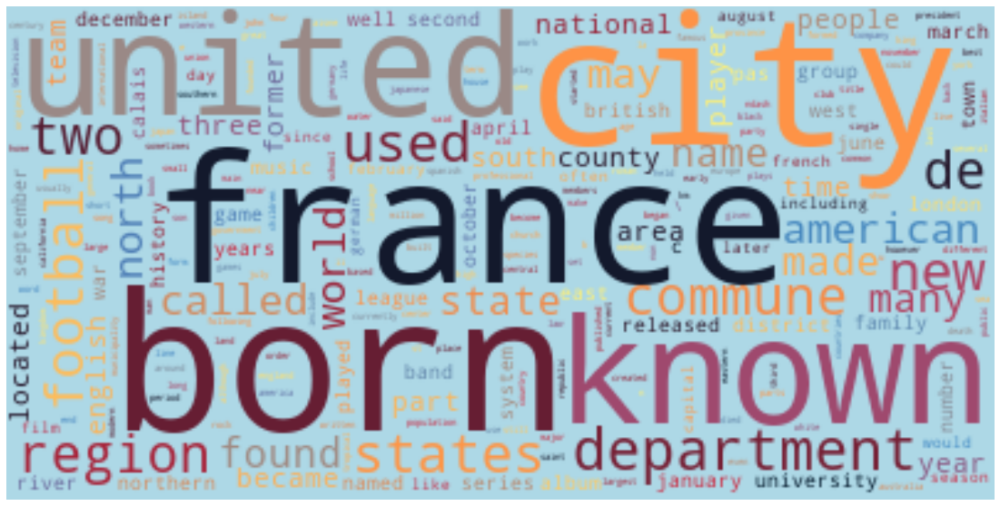

In [16]:
viz_engine.simple_wordcloud(df,'lightblue')

### *2.1.2 Simple Wikipedia Data*

In [17]:
df0 = df[df['label']==0]

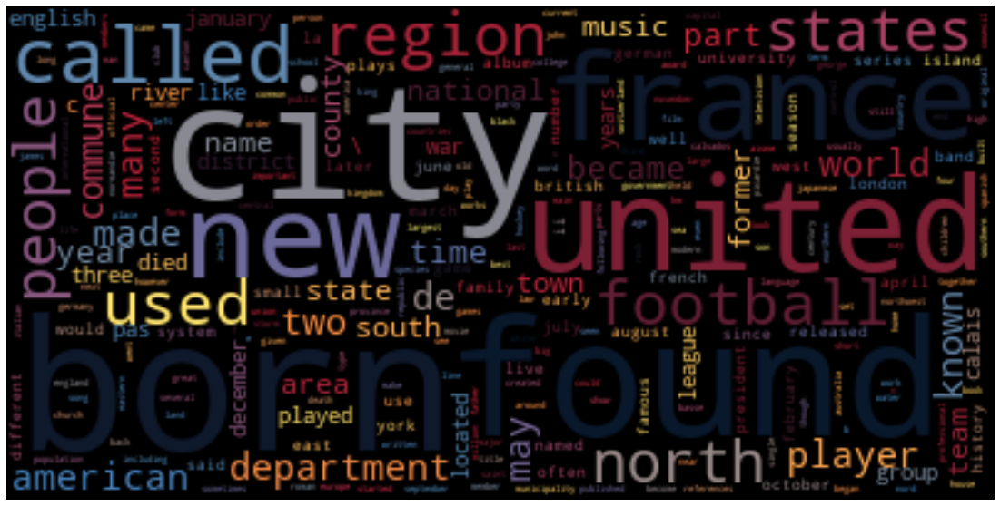

In [18]:
viz_engine.simple_wordcloud(df0,'black')

### *2.1.3 Standard Wikipedia Data*

In [19]:
df1 = df[df['label']==1]

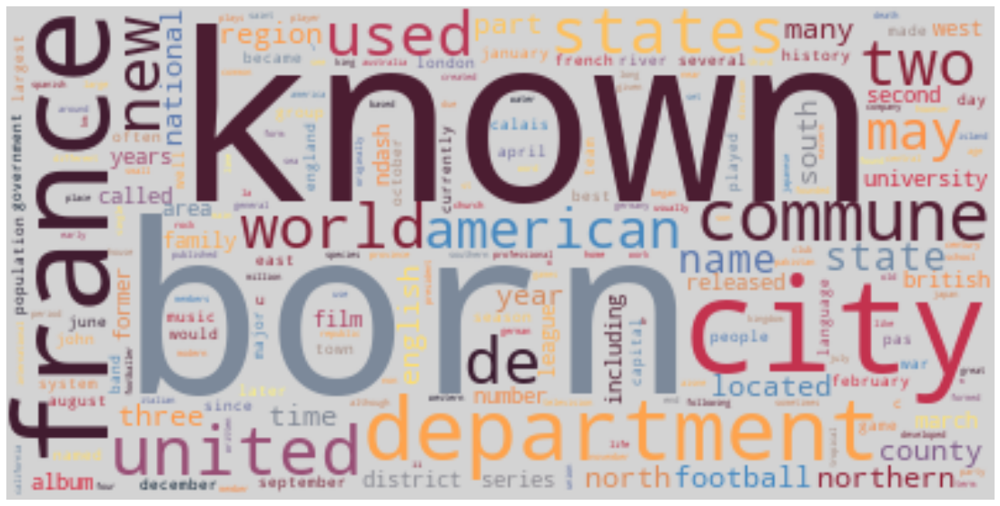

In [20]:
viz_engine.simple_wordcloud(df1,'lightgrey')

## **2.2 Comparative Word Embeddings**

### Word embeddings are a useful technique for comparing corpora--namely, we're able to look at overrepresented words in the datasets as well as analyze the semantic relationships within the text overall. 

In [21]:
#word_embedder.word_embedder(df,'WikiTrain_Large_WordEmbeddings_model')
#word_embedder.word_embedder(df0,'negative_class_WordEmbeddings_model')
#word_embedder.word_embedder(df1,'positive_class_WordEmbeddings_model')

In [22]:
from gensim.models.word2vec import Word2Vec

model = Word2Vec.load('custom_word_embeddings/WikiTrain_Large_WordEmbeddings_model.bin')
model_0 = Word2Vec.load('custom_word_embeddings/negative_class_WordEmbeddings_model.bin')
model_1 = Word2Vec.load('custom_word_embeddings/positive_class_WordEmbeddings_model.bin')

### *2.2.1 Analogy Tests*

### Analogy tests allow for an examination of the relationships between words within a corpora. It is quite incredible that such analogies can be achieved within word embeddings trained on such a relatively small amount of text data. It appears that the relationships between words do differ across 'Simple Wikipedia' and 'Standard Wikipedia'. In many cases, it appears that the word embeddings created from the Standard Wikipedia provide more logical analogies, thereby suggesting a more robust corpus of vocabulary and semantic relationships. 

In [23]:
def analogy_test(model,model_name,something, is_to_something, as_something):
    list_of_analogy = model.wv.most_similar(positive=[as_something,is_to_something], negative = [something])
    most_likely = list_of_analogy[0][0]
    output = '{} : {} is to {} as {} is to: {}'.format(model_name,something.upper(), is_to_something.upper(), as_something.upper(),most_likely.upper())
    
    return print(output)

In [24]:
analogy_test(model,'Full Dataset','man', 'king', 'woman')
analogy_test(model_0,'Simple Wiki','man', 'king', 'woman')
analogy_test(model_1,'Standard Wiki','man', 'king', 'woman')

Full Dataset : MAN is to KING as WOMAN is to: QUEEN
Simple Wiki : MAN is to KING as WOMAN is to: QUEEN
Standard Wiki : MAN is to KING as WOMAN is to: QUEEN


In [25]:
analogy_test(model,'Full Dataset','england', 'london', 'france')
analogy_test(model_0,'Simple Wiki','england', 'london', 'france')
analogy_test(model_1,'Standard Wiki','england', 'london', 'france')

Full Dataset : ENGLAND is to LONDON as FRANCE is to: BRUSSELS
Simple Wiki : ENGLAND is to LONDON as FRANCE is to: ZANGBO
Standard Wiki : ENGLAND is to LONDON as FRANCE is to: MÉTROPOLITAIN


In [26]:
analogy_test(model,'Full Dataset','england', 'london', 'japan')
analogy_test(model_0,'Simple Wiki','england', 'london', 'japan')
analogy_test(model_1,'Standard Wiki','england', 'london', 'japan')

Full Dataset : ENGLAND is to LONDON as JAPAN is to: TOKYO
Simple Wiki : ENGLAND is to LONDON as JAPAN is to: DISTRIBUTORS
Standard Wiki : ENGLAND is to LONDON as JAPAN is to: TOKYO


### *2.2.2 Most Common Words*

#### It appears that the most common words do not significantly differ across datasets.

In [27]:
## Most common words in full dataset

model.wv.index2entity[:20]

['rrb',
 'lrb',
 'also',
 'first',
 'born',
 'one',
 'france',
 'city',
 'united',
 'department',
 'known',
 'states',
 'new',
 'region',
 'commune',
 'used',
 'world',
 'football',
 'two',
 'american']

In [28]:
## Most common words in Simple Wiki dataset

model_0.wv.index2entity[:20]

['rrb',
 'lrb',
 'also',
 'born',
 'first',
 'found',
 'one',
 'france',
 'city',
 'region',
 'united',
 'department',
 'called',
 'football',
 'states',
 'new',
 'people',
 'used',
 'north',
 'made']

In [29]:
## Most common words in Standard Wiki dataset


model_1.wv.index2entity[:20]

['rrb',
 'lrb',
 'also',
 'first',
 'one',
 'born',
 'france',
 'known',
 'city',
 'department',
 'commune',
 'united',
 'new',
 'states',
 'world',
 'two',
 'may',
 'american',
 'used',
 'region']

## *2.2.3 Overrepresented Words*

#### The use of word embeddings allows us to examine words that are overrepresented or underrepresented in either data set. Such semantic distinctions across the corpora may contribute to the effective classification of documents. 

In [30]:
def make_difference_table(size): 
    '''
        This function creates a dataframe words that are over-represented in the positive and negative class.
        params: 
        size = size of initial word list (e.g.1000)
    
    '''
    c = model_0.wv.index2entity[0:size]
    b = model_1.wv.index2entity[0:size]
    
    D = pd.DataFrame(b,columns=['positive'])
    D['negative'] = c
    
    
    diff_dict = {}
    for word in D['positive'].values:
        if word in set(D['negative'].values):
            diff = D[D['negative']==word].index.values[0] - D[D['positive']==word].index.values[0]
            diff_dict[word]=diff
    pos_overrep = sorted(diff_dict.items(), key=lambda item: item[1],reverse=True)[:500]
    neg_overrep = sorted(diff_dict.items(), key=lambda item: item[1],reverse=False)[:500]
    
    R = pd.DataFrame(pos_overrep,columns=["pos_overrep","pos_score"])
    R[["neg_overrep",'neg_score']]=neg_overrep
    
    overrepresented_word_list_pos = []
    overrepresented_word_list_neg = []
    for idx in range(len(pos_overrep)):
        word_pos = pos_overrep[idx][0]
        overrepresented_word_list_pos.append(word_pos)
        
    for idx in range(len(neg_overrep)):
        word_neg = neg_overrep[idx][0]
        overrepresented_word_list_neg.append(word_neg)
        
    return R

In [31]:
differing_vocabulary = make_difference_table(3000)

In [32]:
differing_vocabulary.head(20)

,pos_overrep,pos_score,neg_overrep,neg_score
0,footballer,2130,job,-1913
1,initially,2060,biggest,-1860
2,northwestern,1923,look,-1612
3,numerous,1859,got,-1602
4,derived,1839,say,-1587
5,display,1819,wanted,-1582
6,primarily,1797,eat,-1554
7,regarded,1696,frontier,-1548
8,frequently,1652,beat,-1522
9,respectively,1641,goes,-1403


### Words that are more likely to appear in 'Standard Wikipedia'

In [33]:
list(differing_vocabulary.pos_overrep[:20])

['footballer',
 'initially',
 'northwestern',
 'numerous',
 'derived',
 'display',
 'primarily',
 'regarded',
 'frequently',
 'respectively',
 'roughly',
 'distinct',
 'nicknamed',
 'fifa',
 'ndash',
 'satellite',
 'literally',
 'noted',
 'identified',
 'via']

### Words that are more likely to appear in 'Simple Wikipedia'

In [34]:
list(differing_vocabulary.neg_overrep[:20])

['job',
 'biggest',
 'look',
 'got',
 'say',
 'wanted',
 'eat',
 'frontier',
 'beat',
 'goes',
 'deaths',
 'moons',
 'starts',
 'asked',
 'know',
 'tells',
 'pages',
 'someone',
 'tried',
 'movies']

## *2.2.4 - Visualizing Semantic Similarities and Differences*

### The use of colored matrix representations of the relationship between vocabulary is perhaps a useful way to compare the coherence of semantic information within two datasets. In the below example, it appears that with basic vocabulary, there is little distinction within the data. 

In [35]:
common_words = ['apple','fruit','football','hockey','cow','milk','london','england']

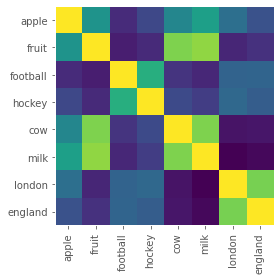

In [36]:
viz_engine.word_embeddings_matrix(model, common_words)

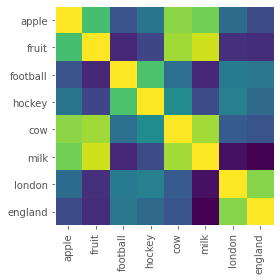

In [37]:
viz_engine.word_embeddings_matrix(model_0, common_words)

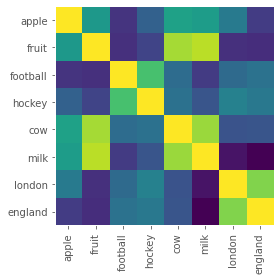

In [38]:
viz_engine.word_embeddings_matrix(model_1, common_words)

In [39]:
common_words = ['footballer',
 'initially',
 'northwestern',
 'numerous',
 'derived',
 'display',
 'primarily',
 'regarded',
 'frequently',
 'respectively',
 'job',
 'biggest',
 'look',
 'got',
 'say',
 'wanted',
 'eat',
 'frontier',
 'beat',
 'goes']

### Nonetheless, when we creat matrices of words that are overrepresented in either data set, we see that the semantic textures of the datsets do indeed differ. As such, we will use different text representations to incorporate semantic information into our classification tasks. 

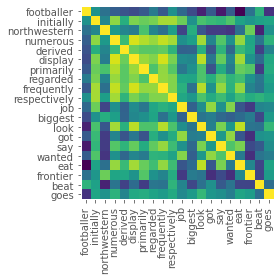

In [40]:
viz_engine.word_embeddings_matrix(model_0, common_words)

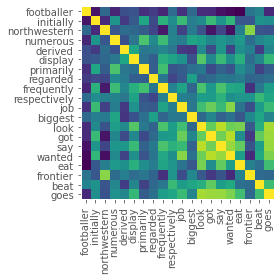

In [41]:
viz_engine.word_embeddings_matrix(model_1, common_words)

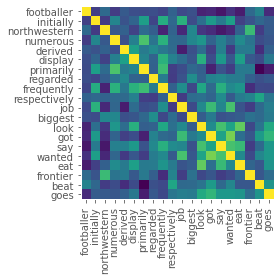

In [42]:
viz_engine.word_embeddings_matrix(model, common_words)

### Resources 

* Homework Assignment 2: Information Visualization II, by Professor Eytan Adar
* https://towardsdatascience.com/visualizing-word-embedding-with-pca-and-t-sne-961a692509f5#:~:text=To%20visualize%20the%20word%20embedding%2C%20we%20are%20going%20to%20use,embedding%20GloVe%20will%20be%20implemented. 
* https://towardsdatascience.com/visualization-of-word-embedding-vectors-using-gensim-and-pca-8f592a5d3354
* https://altair-viz.github.io/gallery/
* https://www.coursera.org/projects/interactive-word2vec
* https://www.kaggle.com/jeffd23/visualizing-word-vectors-with-t-sne
* https://jalammar.github.io/illustrated-word2vec/


## Thanks! 